In [1]:
import face_recognition as fr
import matplotlib.pyplot as plt
import progressbar
import numpy as np
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d import proj3d
from matplotlib import offsetbox
import tqdm
%matplotlib widget


In [3]:
image = fr.load_image_file("input/0576.JPG")
face_locations = fr.face_locations(image)


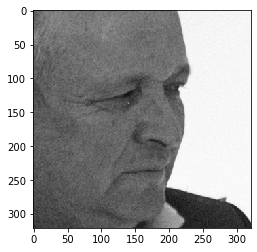

In [43]:
image_cord = face_locations[3]
plt.imshow(image[image_cord[0]:image_cord[2], image_cord[3]:image_cord[1], :], interpolation='nearest')


In [4]:
names = [f'input/{str(x).zfill(4)}.JPG' for x in range(579)]
face_locations = []
face_embeddings = []

bar = progressbar.ProgressBar(maxval=len(names), widgets=[
    f'Processing {len(names)} images: ',
    progressbar.Bar(marker='#', left='[', right=']', fill='.'),
    progressbar.Percentage(),
    progressbar.Counter()
]).start()

for i, name in enumerate(names):
    bar.update(i)
    image = fr.load_image_file(name)
    face_locations.append(fr.face_locations(image))
    face_embeddings.append(fr.face_encodings(image))


KeyboardInterrupt: 

In [ ]:
import pickle

with open('face_embeddings.pkl', 'wb') as f:
    pickle.dump(face_embeddings, f)

with open('face_locations.pkl', 'wb') as f:
    pickle.dump(face_locations, f)


In [2]:
import pickle

with open('face_embeddings.pkl', 'rb') as f:
    face_embeddings = pickle.load(f)

with open('face_locations.pkl', 'rb') as f:
    face_locations = pickle.load(f)


In [162]:
emb = []
for e in face_embeddings:
    emb.extend(e)
emb = np.array(emb)


In [171]:
len(emb)

1279

In [172]:
1279 / 10

127.9

In [170]:
from PIL import Image

faces = []

for i, name in enumerate(tqdm.tqdm(names)):
    image = fr.load_image_file(name)
    for fc in face_locations[i]:
        # PIL_image = Image.fromarray(
        # np.uint8(image[fc[0]:fc[2], fc[3]:fc[1], :])).convert('RGB')

        # PIL_image = PIL_image.resize((10, 10))
        # faces.append(np.array(PIL_image))

        faces.append(image[fc[0]:fc[2], fc[3]:fc[1], :])


100%|██████████| 579/579 [02:00<00:00,  4.82it/s]


In [69]:
pca = PCA(n_components=3)
transformed_emb = pca.fit_transform(emb)


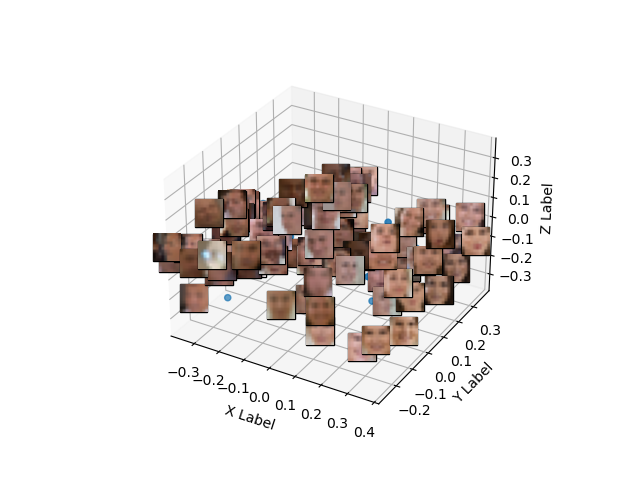

In [102]:
fig = plt.figure()
ax = fig.add_subplot(111, projection=Axes3D.name)

xs = transformed_emb[:, 0]
ys = transformed_emb[:, 1]
zs = transformed_emb[:, 2]

ax.scatter(xs, ys, zs, marker="o")

ax2 = fig.add_subplot(111, frame_on=False)
ax2.axis("off")
ax2.axis([0, 1, 0, 1])


class ImageAnnotations3D():
    def __init__(self, xyz, imgs, ax3d, ax2d):
        self.xyz = xyz
        self.imgs = imgs
        self.ax3d = ax3d
        self.ax2d = ax2d
        self.annot = []
        for s, im in zip(self.xyz, self.imgs):
            x, y = self.proj(s)
            self.annot.append(self.image(im, [x, y]))
        self.lim = self.ax3d.get_w_lims()
        self.rot = self.ax3d.get_proj()
        self.cid = self.ax3d.figure.canvas.mpl_connect(
            "draw_event", self.update)

        self.funcmap = {"button_press_event": self.ax3d._button_press,
                        "motion_notify_event": self.ax3d._on_move,
                        "button_release_event": self.ax3d._button_release}

        self.cfs = [self.ax3d.figure.canvas.mpl_connect(kind, self.cb)
                    for kind in self.funcmap.keys()]

    def cb(self, event):
        event.inaxes = self.ax3d
        self.funcmap[event.name](event)

    def proj(self, X):
        """ From a 3D point in axes ax1, 
            calculate position in 2D in ax2 """
        x, y, z = X
        x2, y2, _ = proj3d.proj_transform(x, y, z, self.ax3d.get_proj())
        tr = self.ax3d.transData.transform((x2, y2))
        return self.ax2d.transData.inverted().transform(tr)

    def image(self, arr, xy):
        """ Place an image (arr) as annotation at position xy """
        im = offsetbox.OffsetImage(arr, zoom=2)
        im.image.axes = ax
        ab = offsetbox.AnnotationBbox(im, xy, xybox=(0., 0.),
                                      xycoords='data', boxcoords="offset points",
                                      pad=0.)
        self.ax2d.add_artist(ab)
        return ab

    def update(self, event):
        if np.any(self.ax3d.get_w_lims() != self.lim) or \
                np.any(self.ax3d.get_proj() != self.rot):
            self.lim = self.ax3d.get_w_lims()
            self.rot = self.ax3d.get_proj()
            for s, ab in zip(self.xyz, self.annot):
                ab.xy = self.proj(s)


# imgs = [np.random.rand(10, 10) for i in range(len(xs))]
imgs = faces
ia = ImageAnnotations3D(np.c_[xs, ys, zs], imgs, ax, ax2)

ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')
plt.show()


In [155]:
from sklearn.cluster import DBSCAN

clustering = DBSCAN(eps=0.4, min_samples=2).fit(emb)
clustering.labels_


array([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,  0, -1, -1, -1, -1,  1,
        0,  2,  1, -1, -1, -1, -1, -1, -1, -1, -1, -1,  3, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1,  3, -1, -1, -1, -1, -1,  4, -1, -1,  4, -1, -1, -1, -1, -1,  5,
       -1,  5,  6,  6, -1, -1,  5,  2,  0,  2, -1, -1, -1, -1, -1, -1, -1,
       -1, -1, -1, -1])

In [114]:
clustering.labels_ == 0


array([ True,  True, False, False, False,  True,  True,  True,  True,
        True, False,  True, False,  True, False, False, False,  True,
       False, False,  True, False, False,  True,  True,  True,  True,
       False,  True, False,  True, False, False, False, False,  True,
        True, False,  True, False,  True, False, False, False, False,
       False,  True,  True, False,  True, False,  True, False,  True,
       False, False, False,  True, False, False, False, False, False,
        True,  True, False, False,  True,  True,  True,  True,  True,
       False, False,  True, False,  True, False,  True,  True,  True,
       False, False, False, False, False, False,  True,  True])

In [117]:
faces = np.array(faces)


/var/folders/_0/jg31z24j4s78_r7b93bhvd400000gn/T/ipykernel_80472/1884837288.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  faces = np.array(faces)


In [122]:
faces[clustering.labels_ == 0].shape


(41,)

In [173]:
def plot_figures(figures, nrows=1, ncols=1):
    fig = plt.figure(figsize=(ncols, nrows))

    ax = []

    for i in range(1, len(figures) + 1):
        # img = np.random.randint(10, size=(h, w))
        img = figures[i - 1]
        ax.append(fig.add_subplot(nrows, ncols, i))
        # ax[-1].set_title(figures[i - 1][0])
        plt.axis('off')
        plt.imshow(img)
    plt.show()


In [174]:
len(faces)

1279

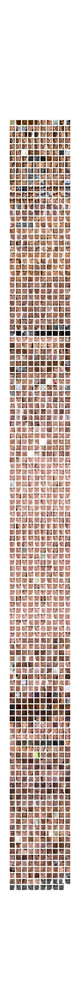

In [175]:
label = -1

# imgs = faces[clustering.labels_ == label]

number_of_im = len(faces)

figures = [faces[i] for i in range(number_of_im)]

plot_figures(figures, 128, 10)
